## Dataset examples

- Le corpus de données du projet JRC-Acquis 
Ce corpus est une collection de textes multilingues couvrant les domaines de la législation, des politiques et de l'administration de l'Union européenne. Le corpus comprend plus de 20 langues européennes, y compris le français, et est annoté par catégorie, telle que la législation, les politiques agricoles, l'environnement, etc. Vous pouvez utiliser cet ensemble de données pour entraîner des modèles de classification de textes multilingues qui peuvent classer des phrases en fonction de leur catégorie.

https://joint-research-centre.ec.europa.eu/language-technology-resources/jrc-acquis_en#download-the-jrc-acquis-corpus

https://wt-public.emm4u.eu/Acquis/JRC-Acquis.3.0/corpus/

- European Parliament Proceedings Parallel Corpus 1996-2011
Ce corpus est une collection de textes multilingues qui couvrent les débats du Parlement européen entre 1996 et 2011. Il comprend des traductions en français, anglais, espagnol, italien, allemand, portugais, suédois, tchèque, polonais, grec et finnois. Les textes sont alignés par phrase et peuvent être utilisés pour des tâches de traduction automatique et d'analyse de texte.

https://www.statmt.org/europarl/

- Corpus Est Républicain 

Le corpus Est Républicain est un corpus journalistique composé d'articles parus dans le quotidien l'Est Républicain entre 1999 et 2003. La version initiale du corpus est mise à disposition sur Ortolang au format texte, encodé en TEI P5 (titres, paragraphes, etc.).

http://redac.univ-tlse2.fr/corpus/estRepublicain.html

- Corpus TALN articles scientifiques issus des actes des conférences TALN et RECITAL de 1997 à 2019

Le corpus TALN rassemble les articles des conférences TALN et RÉCITAL des années 1997 à 2019.
Il se compose de 1602 articles scientifiques en français qui traitent du domaine du traitement automatique des langues (TAL) pour un total de 5,8 millions de mots.

http://redac.univ-tlse2.fr/corpus/taln.html

- sklearn dataset : fetch_20newsgroups

https://towardsdatascience.com/topic-modeling-with-bert-779f7db187e6
https://scikit-learn.org/stable/modules/generated/sklearn.datasets.fetch_20newsgroups.html

## Europarl dataset

In [60]:
from sentence_transformers import SentenceTransformer, util
import pandas as pd
import missingno as msno
from sklearn.manifold import TSNE
import plotly.express as px
import plotly.graph_objects as go

In [3]:
# dataset-from https://www.statmt.org/europarl/ and following work from nowbrains
df = pd.read_fwf("europarl-v7.fr-en.fr", header=None, sep='\n')
df.head(10)

,0,1,2,3,4,5,6,7,8,9,10
0,Reprise de la session,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Je déclare reprise la session du Parlement eur...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,"Comme vous avez pu le constater, le grand ""bog...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Vous avez souhaité un débat à ce sujet dans le...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,"En attendant, je souhaiterais, comme un certai...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Je vous invite à vous lever pour cette minute ...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,"(Le Parlement, debout, observe une minute de s...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,"Madame la Présidente, c'est une motion de proc...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Vous avez probablement appris par la presse et...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,L'une des personnes qui vient d'être assassiné...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<Axes: >

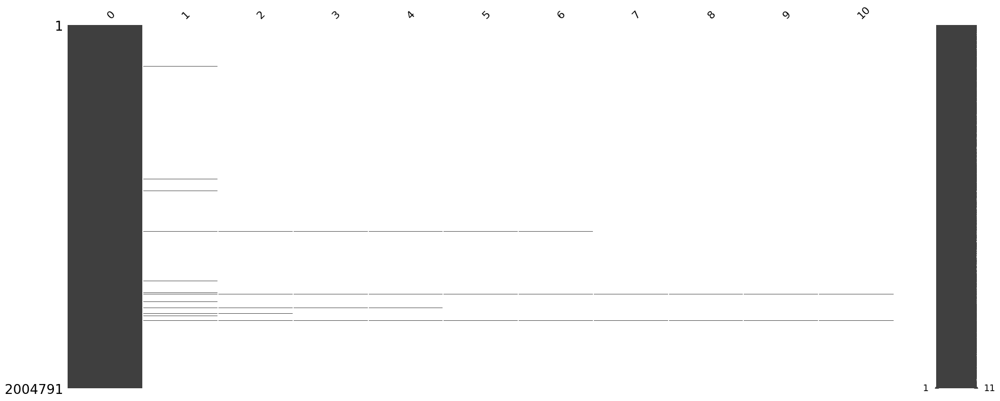

In [4]:
msno.matrix(df)

In [5]:
# on enlève les quelques phrases qui ne rentrent pas dans la première cellule (>127 char) et on prend que les 30 000 1eres phrases
df2 = df[0].iloc[:30000]
df_final = df2.copy()

In [6]:
df_final.head(10)

0                                Reprise de la session
1    Je déclare reprise la session du Parlement eur...
2    Comme vous avez pu le constater, le grand "bog...
3    Vous avez souhaité un débat à ce sujet dans le...
4    En attendant, je souhaiterais, comme un certai...
5    Je vous invite à vous lever pour cette minute ...
6    (Le Parlement, debout, observe une minute de s...
7    Madame la Présidente, c'est une motion de proc...
8    Vous avez probablement appris par la presse et...
9    L'une des personnes qui vient d'être assassiné...
Name: 0, dtype: object

In [7]:
def remove_special_characters(text):
    """
    Input: str : A string to clean from non alphanumeric characters
    Output: str : The same strings without non alphanumeric characters
    """
    #TOFILL
    pattern = r'[^a-zA-z0-9\s]'
    text = re.sub(pattern, '', text)
    return text


def lowercase_text(text):
    """
    Input: str : A string to lowercase
    Output: str : The same string lowercased
    """
    #TOFILL
    return text.lower()

def tokenize_words(text):
    """
    Input: str : A string to tokenize
    Output: list of str : A list of the tokens splitted from the input string
    """
    #TOFILL
    tokenizer=ToktokTokenizer()
    return tokenizer.tokenize(text)

def remove_stopwords(token_list):
    """
    Input: list of str : A list of tokens
    Output: list of str : The new list with removed stopwords tokens
    """
    #TOFILL
    stopword_list=set(nltk.corpus.stopwords.words('english'))
    return [token for token in token_list if token not in stopword_list]

def stem_words(token_list):
    """
    Input: list of str : A list of tokens to stem
    Output: list of str : The list of stemmed tokens
    """
    #TOFILL
    ps = nltk.porter.PorterStemmer()
    return [ps.stem(token) for token in token_list]

In [8]:
model = SentenceTransformer('paraphrase-multilingual-MiniLM-L12-v2')
embeddings = model.encode(df2, convert_to_tensor=True)
embeddings_u = model.encode(df2, show_progress_bar=True)

Batches:   0%|          | 0/938 [00:00<?, ?it/s]

### T-SNE dimension reduction

In [9]:
nemb = embeddings.cpu().numpy() #convert PyTorch CUDA tensor to NumPy array
view_2 = TSNE(n_components=2, random_state=123, n_jobs=-1).fit_transform(nemb)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [10]:
df2=df2.to_frame()
df2.rename(columns={0: 'discours'}, inplace=True)
df2.head()
df_TSNE = df2.copy()
df_TSNE["x"] = view_2[:,0]
df_TSNE["y"] = view_2[:,1]
df_TSNE.to_csv("df_TSNE.csv", sep="|")

In [11]:
df_TSNE

,discours,x,y
0,Reprise de la session,-36.211815,-78.956963
1,Je déclare reprise la session du Parlement eur...,1.782145,-88.289162
2,"Comme vous avez pu le constater, le grand ""bog...",-59.332058,-0.278800
3,Vous avez souhaité un débat à ce sujet dans le...,-14.472909,-42.717445
4,"En attendant, je souhaiterais, comme un certai...",21.947351,39.184303
...,...,...,...
29995,Comme le dit un proverbe espagnol - qui convie...,-41.867172,-46.390144
29996,"Aussi, mon groupe va soutenir le rapport du ra...",17.952749,-51.908440
29997,"Néanmoins, je voudrais souligner que l' on a r...",14.660518,54.294418
29998,"Par ailleurs, la demande de vesces pour l' ali...",-73.980301,0.011226


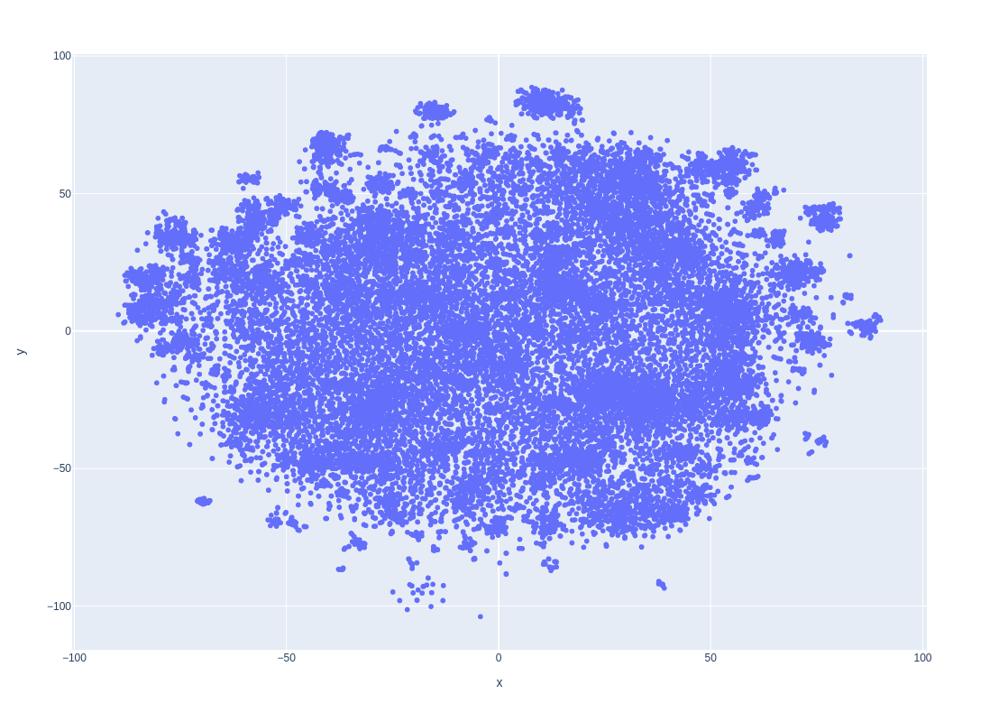

In [12]:
df_TSNE = pd.read_csv("df_TSNE.csv", sep="|")
fig = px.scatter(
    df_TSNE, 
    x="x", y="y",
    width=1100, height=800
    )
fig.show()

### UMAP dimension reduction

Now following : https://towardsdatascience.com/topic-modeling-with-bert-779f7db187e6

In [13]:
import umap
umap_embeddings = umap.UMAP(n_neighbors=15, 
                            n_components=5, 
                            metric='cosine').fit_transform(embeddings_u)

/home/pfcynapps/miniconda3/envs/nlp/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning:

The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.

/home/pfcynapps/miniconda3/envs/nlp/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning:

The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.

/home/pfcynapps/miniconda3/envs/nlp/lib/python3.9/site-packages/umap/distances.py:1086: NumbaDep

### Clustering via hdbscan

In [14]:
import hdbscan
cluster = hdbscan.HDBSCAN(min_cluster_size=30,
                          metric='euclidean',                      
                          cluster_selection_method='eom').fit(umap_embeddings)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

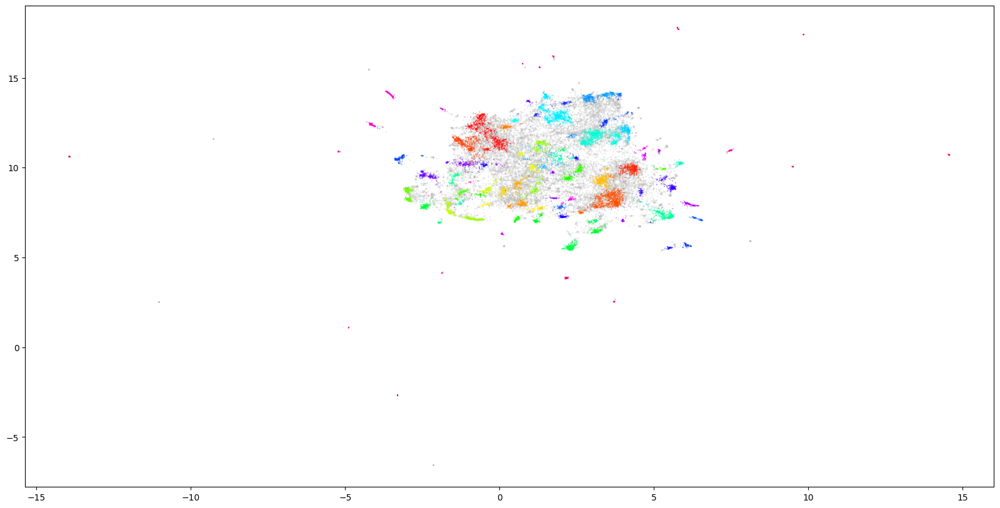

In [15]:
import matplotlib.pyplot as plt

# Prepare data -> To visualize the resulting clusters we can further reduce the dimensionality to 2
umap_data = umap.UMAP(n_neighbors=15, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings_u)
result = pd.DataFrame(umap_data, columns=['x', 'y'])
result['labels'] = cluster.labels_

# Visualize clusters
fig, ax = plt.subplots(figsize=(20, 10))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='#BDBDBD', s=0.05)
plt.scatter(clustered.x, clustered.y, c=clustered.labels, s=0.05, cmap='hsv_r')

### Deriving topics from clustered documents

In [16]:
#1. creating a single document for each cluster of documents
docs_df = pd.DataFrame(df2, columns=["discours"])
docs_df['Topic'] = cluster.labels_
docs_df['Doc_ID'] = range(len(docs_df))
docs_per_topic = docs_df.groupby(['Topic'], as_index = False).agg({'discours': ' '.join})

In [17]:
docs_per_topic.iloc[1]

Topic                                                       0
discours    (Applaudissements du groupe PSE) (Applaudissem...
Name: 1, dtype: object

In [18]:
import spacy
lemm = spacy.load('fr_core_news_md')

def lemm_words(token_list):
    """
    Input: list of str : A list of tokens to lemmatize
    Output: list of str : The list of lemmatize tokens
    """
    doc = lemm(token_list)
    return [token.lemma_ for token in doc]

docs_per_topic_lem = docs_per_topic.copy()
docs_per_topic_lem = docs_per_topic_lem.drop(labels=0, axis=0)
docs_per_topic_lem['discours']=docs_per_topic_lem['discours'].apply(lemm_words)
docs_per_topic_lem['discours']=docs_per_topic_lem['discours'].apply(lambda x: ' '.join(x))

In [19]:
docs_per_topic_lem

,Topic,discours
1,0,( applaudissement de groupe PSE ) ( applaudiss...
2,1,question no 28 de ( h-0781/99 ) : question no ...
3,2,le débat être clore . le débat être clore . le...
4,3,"( le séance être lever à 20h25 ) ( le séance ,..."
5,4,rapport Koch ( a5 - 0105/1999 ) rapport Koch (...
...,...,...
92,91,"s ' agir de lundi et mardi , je ne ' avoir pas..."
93,92,je être de accord sur le fait que le parlement...
94,93,je vouloir demander à le vice-présidente si lu...
95,94,nous devoir faire quelque chose pour remédier ...


In [20]:
#2. Quantifying a single importance value for each word in a cluster which can be used to create the topic

import numpy as np
from sklearn.feature_extraction.text import CountVectorizer
import nltk

nltk.download('stopwords')
stopwords = nltk.corpus.stopwords.words('french')
stopwords = stopwords+['avoir']+['être']

def c_tf_idf(documents, m, ngram_range=(1, 1)):
    count = CountVectorizer(ngram_range=ngram_range, stop_words=stopwords).fit(documents)
    t = count.transform(documents).toarray() # count frequency of each word in each cluster
    w = t.sum(axis=1) # count number of word in each cluster
    tf = np.divide(t.T, w) # term frequency in each cluster
    sum_t = t.sum(axis=0) # count number of a given word in all joined clusters
    idf = np.log(np.divide(m, sum_t)).reshape(-1, 1) # un mot rare a un poids plus fort
    tf_idf = np.multiply(tf, idf)

    return tf_idf, count
  
tf_idf, count = c_tf_idf(docs_per_topic_lem.discours.values, m=len(df2))
tf_idf.shape

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/pfcynapps/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


(10001, 96)

In [246]:
#3. Topic Representation: The higher the score, the more representative it should be of its topic
def extract_top_n_words_per_topic(tf_idf, count, docs_per_topic, n=20):
    words = count.get_feature_names_out()
    labels = list(docs_per_topic.Topic)
    tf_idf_transposed = tf_idf.T
    indices = tf_idf_transposed.argsort()[:, -n:]
    top_n_words = {label: [(words[j], tf_idf_transposed[i][j]) for j in indices[i]][::-1] for i, label in enumerate(labels)}
    return top_n_words

def extract_topic_sizes(df):
    topic_sizes = (df.groupby(['Topic'])
                     .discours
                     .count()
                     .reset_index()
                     .rename({"Topic": "Topic", "discours": "Size"}, axis='columns')
                     .sort_values("Size", ascending=False))
    return topic_sizes

top_n_words = extract_top_n_words_per_topic(tf_idf, count, docs_per_topic_lem, n=20)
topic_sizes = extract_topic_sizes(docs_df); topic_sizes.head(25)

,Topic,Size
0,-1,16328
91,90,837
47,46,705
96,95,702
50,49,620
92,91,454
54,53,435
84,83,356
59,58,351
94,93,319


In [22]:
# stem_words(token_list)
top_n_words

{0: [('applaudissement', 3.9896640724845147),
  ('vif', 0.7489335947265612),
  ('protestation', 0.4022571553141995),
  ('pse', 0.38320494602056837),
  ('droite', 0.34487756623871857),
  ('prolonger', 0.2789664786089646),
  ('gauche', 0.2534148920877314),
  ('groupe', 0.22603329584980655),
  ('centre', 0.10743492791681644),
  ('quelque', 0.08002888139396683),
  ('dépouiller', 0.0),
  ('dépourvoir', 0.0),
  ('dépourvu', 0.0),
  ('dépêche', 0.0),
  ('dépréciation', 0.0),
  ('déprécier', 0.0),
  ('dépositaire', 0.0),
  ('déposion', 0.0),
  ('déposer', 0.0),
  ('députe', 0.0)],
 1: [('00', 0.978570492909342),
  ('question', 0.7616049726093772),
  ('numéro', 0.7524930878991929),
  ('no', 0.5150619439943622),
  ('99', 0.4383367237148449),
  ('44', 0.0828474273721254),
  ('41', 0.08060101578171389),
  ('42', 0.07964151732730794),
  ('39', 0.07876556386768079),
  ('45', 0.07178757211707731),
  ('nº', 0.06453560724888824),
  ('51', 0.061814364912591825),
  ('36', 0.053734010521142586),
  ('38', 

In [23]:
#3. Topic Reduction
# from sklearn.metrics.pairwise import cosine_similarity
# for i in range(20):
#     # Calculate cosine similarity
#     similarities = cosine_similarity(tf_idf.T)
#     np.fill_diagonal(similarities, 0)

#     # Extract label to merge into and from where
#     topic_sizes = docs_df.groupby(['Topic']).count().sort_values("discours", ascending=False).reset_index()
#     topic_to_merge = topic_sizes.iloc[-1].Topic
#     topic_to_merge_into = np.argmax(similarities[topic_to_merge + 1]) - 1

#     # Adjust topics
#     docs_df.loc[docs_df.Topic == topic_to_merge, "Topic"] = topic_to_merge_into
#     old_topics = docs_df.sort_values("Topic").Topic.unique()
#     map_topics = {old_topic: index - 1 for index, old_topic in enumerate(old_topics)}
#     docs_df.Topic = docs_df.Topic.map(map_topics)
#     docs_per_topic = docs_df.groupby(['Topic'], as_index = False).agg({'discours': ' '.join})

#     # Calculate new topic words
#     m = len(df2)
#     tf_idf, count = c_tf_idf(docs_per_topic.discours.values, m)
#     top_n_words = extract_top_n_words_per_topic(tf_idf, count, docs_per_topic, n=20)

# topic_sizes = extract_topic_sizes(docs_df); topic_sizes.head(10)

(3.0, 14.0)

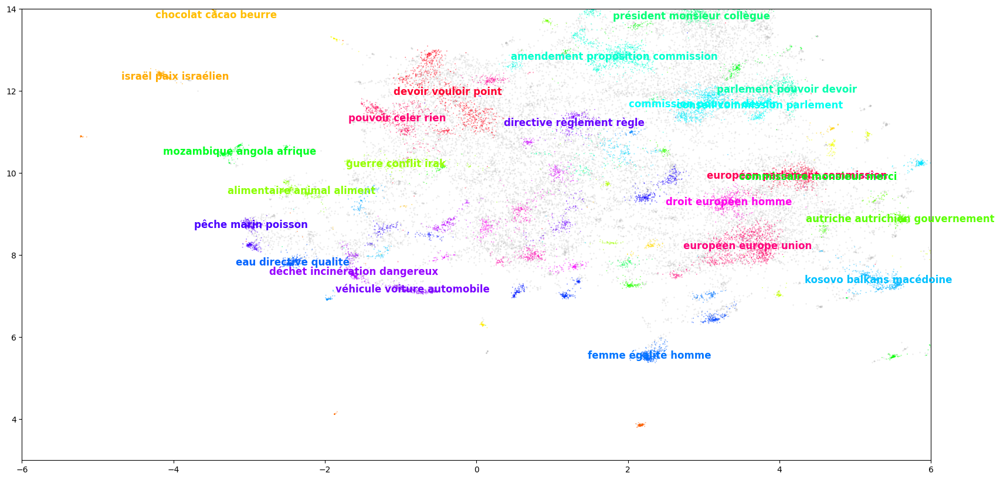

In [24]:
# Visualize clusters
fig, ax = plt.subplots(figsize=(20, 10))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='#BDBDBD', s=0.05)
a=plt.scatter(clustered.x, clustered.y, c=clustered.labels, s=0.05, cmap='hsv')

cmap = plt.cm.hsv
cmaplist = [cmap(i) for i in range(cmap.N)]

x_mean = clustered.groupby(['labels'])['x'].mean()
y_mean = clustered.groupby(['labels'])['y'].mean()

for i in range(1,25):
    topic = topic_sizes.Topic.iloc[i]
    label = top_n_words[topic][0][0]+' '+top_n_words[topic][1][0]+' '+top_n_words[topic][2][0]
    plt.annotate(label, 
                 (x_mean[topic],y_mean[topic]),
                 horizontalalignment='center',
                 verticalalignment='center',
                 size=12, weight='bold',
                 c=cmaplist[round(topic/len(topic_sizes)*cmap.N)]) 
plt.xlim(-6, 6)  
plt.ylim(3, 14)  

In [29]:
clustered['discours']=df_TSNE['discours'][2::]

/tmp/ipykernel_4426/3323025122.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [30]:
clustered

,x,y,labels,discours
2,-1.467068,9.530638,54,"Comme vous avez pu le constater, le grand ""bog..."
3,0.313081,12.299180,87,Vous avez souhaité un débat à ce sujet dans le...
16,1.938595,10.525509,51,Le paragraphe 6 du rapport Cunha sur les progr...
18,-3.033956,8.692797,70,"À mon sens, le principe de stabilité relative ..."
25,5.521442,5.526649,32,"Merci, Monsieur Segni, je le ferai bien volont..."
...,...,...,...,...
29979,2.142898,12.756555,46,"Deuxièmement, l' amendement 2 du Parlement pro..."
29987,-0.389165,8.808391,76,"Dès lors, Monsieur le Président, la commission..."
29996,2.132695,13.078028,46,"Aussi, mon groupe va soutenir le rapport du ra..."
29998,-2.570526,9.545071,24,"Par ailleurs, la demande de vesces pour l' ali..."


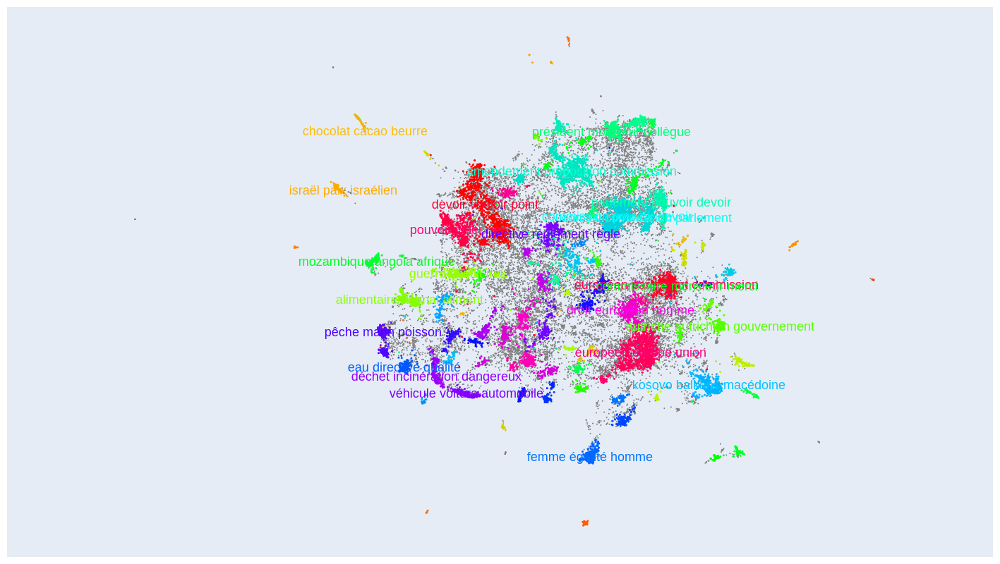

In [122]:
import matplotlib as mp

fig = px.scatter(
    clustered, 
    x="x", y="y",
    width=1100, height=800,
    hover_data=['discours'],
    color=clustered.labels,
    color_continuous_scale='hsv')

fig.update_yaxes(
    scaleanchor = "x",
    scaleratio = 1,
    visible=False
    )
fig.update_xaxes(
    visible=False
    )
fig.update_layout(
    margin=dict(l=10, r=10, t=10, b=10),
    legend= {'itemsizing': 'constant'}
    )
fig.update_traces(
    marker=dict(size=3), 
    hovertemplate="%{customdata[0]}"
    )
fig.update_coloraxes(showscale=False)

fig.add_trace(go.Scatter(x=outliers.x, y=outliers.y,
                    mode='markers',
                    marker = {'color' : 'grey', 'size' : 2},
                    hoverinfo='skip'))

for i in range(1,25):
    topic = topic_sizes.Topic.iloc[i]
    label = top_n_words[topic][0][0]+' '+top_n_words[topic][1][0]+' '+top_n_words[topic][2][0]
    color = cmaplist[round(topic/len(topic_sizes)*cmap.N)]
    hexcolor = mp.colors.to_hex(color, keep_alpha=False)
    fig.add_annotation(x=x_mean[topic], y=y_mean[topic],
            text=label,
            showarrow=False,
            font=dict(
                size=18,
                color=str(hexcolor))
            )

fig.update_layout(yaxis_range=[3,17])
fig.update_layout(xaxis_range=[-3,3])
fig.update(layout_showlegend=False)

fig.show()

### Allocate a sentence to its category 

In [306]:
base_sentence = 'Il est important de préciser que le chocolat est une préparation à base de cacao et de beurre de cacao'

embeddings1 = model.encode([base_sentence], convert_to_tensor=True)
embeddings1_u = model.encode([base_sentence], show_progress_bar=True)
docs_per_topic_lem['discours'].reset_index(drop=True, inplace=True)
embeddings2 = model.encode(docs_per_topic_lem['discours'], convert_to_tensor=True)

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

In [307]:
import torch
def compute_best_index(ticket, other_tickets, other_embeddings):
    embeddings = model.encode([ticket], convert_to_tensor=True)
    cosine_scores = util.cos_sim(embeddings, other_embeddings).cpu().numpy()[0]
    best_index = cosine_scores.argmax()
    return best_index

idx = compute_best_index(base_sentence, docs_per_topic_lem['discours'], embeddings2)
label = top_n_words[idx][0][0]+' '+top_n_words[idx][1][0]+' '+top_n_words[idx][2][0]
print(label)

chocolat cacao beurre


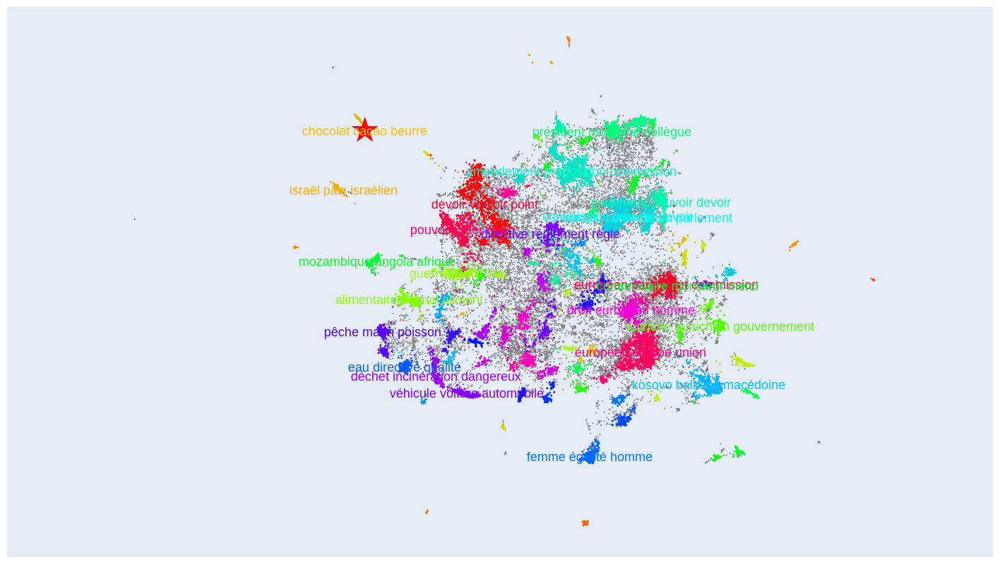

In [308]:
import matplotlib as mp

fig = px.scatter(
    clustered, 
    x="x", y="y",
    width=1100, height=800,
    hover_data=['discours'],
    color=clustered.labels,
    color_continuous_scale='hsv')

fig.update_yaxes(
    scaleanchor = "x",
    scaleratio = 1,
    visible=False
    )
fig.update_xaxes(
    visible=False
    )
fig.update_layout(
    margin=dict(l=10, r=10, t=10, b=10),
    legend= {'itemsizing': 'constant'}
    )
fig.update_traces(
    marker=dict(size=3), 
    hovertemplate="%{customdata[0]}"
    )
fig.update_coloraxes(showscale=False)

fig.add_trace(go.Scatter(x=outliers.x, y=outliers.y,
                    mode='markers',
                    marker = {'color' : 'grey', 'size' : 2},
                    hoverinfo='skip'))

for i in range(1,25):
    topic = topic_sizes.Topic.iloc[i]
    label = top_n_words[topic][0][0]+' '+top_n_words[topic][1][0]+' '+top_n_words[topic][2][0]
    color = cmaplist[round(topic/len(topic_sizes)*cmap.N)]
    hexcolor = mp.colors.to_hex(color, keep_alpha=False)
    fig.add_annotation(x=x_mean[topic], y=y_mean[topic],
            text=label,
            showarrow=False,
            font=dict(
                size=18,
                color=str(hexcolor))
            )

fig.add_trace(
    go.Scattergl(
        x=np.array(x_mean[idx]), y=np.array(y_mean[idx]),
        marker=dict(symbol='star', size=30, color="red"),
        name="Centers",
        mode="markers",
    )
)
fig.update_layout(yaxis_range=[3,17])
fig.update_layout(xaxis_range=[-3,3])
fig.update(layout_showlegend=False)

fig.show()